**Подключение библиотек и скриптов**

In [1]:
import pandas as pd
import numpy as np
import pickle
import random

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, ShuffleSplit, cross_val_score, learning_curve
from sklearn.model_selection import KFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, precision_score, recall_score

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb, lightgbm as lgbm, catboost as catb

import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
import warnings
# warnings.simplefilter('ignore')

In [3]:
import pandas_profiling

**Пути к директориям и файлам**

In [4]:
# input
DATASET_PATH = 'course_project_train.csv'

# output
PREP_DATASET_PATH = 'course_project_train_prep.csv'

In [5]:
# output
TRAIN_FULL_PATH = 'training_project_train_full.csv'
TRAIN_PART_PATH = 'training_project_train_part_b.csv'
TEST_PART_PATH = 'training_project_test_part.csv'

SCALER_FILE_PATH = 'scaler.pkl'

### Загрузка данных<a class="anchor" id="load_data"></a>

In [6]:
df = pd.read_csv(DATASET_PATH)
df.head()

,Home Ownership,Annual Income,Years in current job,Tax Liens,Number of Open Accounts,Years of Credit History,Maximum Open Credit,Number of Credit Problems,Months since last delinquent,Bankruptcies,Purpose,Term,Current Loan Amount,Current Credit Balance,Monthly Debt,Credit Score,Credit Default
0,Own Home,482087.0,NaN,0.0,11.0,26.3,685960.0,1.0,NaN,1.0,debt consolidation,Short Term,99999999.0,47386.0,7914.0,749.0,0
1,Own Home,1025487.0,10+ years,0.0,15.0,15.3,1181730.0,0.0,NaN,0.0,debt consolidation,Long Term,264968.0,394972.0,18373.0,737.0,1
2,Home Mortgage,751412.0,8 years,0.0,11.0,35.0,1182434.0,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,308389.0,13651.0,742.0,0
3,Own Home,805068.0,6 years,0.0,8.0,22.5,147400.0,1.0,NaN,1.0,debt consolidation,Short Term,121396.0,95855.0,11338.0,694.0,0
4,Rent,776264.0,8 years,0.0,13.0,13.6,385836.0,1.0,NaN,0.0,debt consolidation,Short Term,125840.0,93309.0,7180.0,719.0,0


In [7]:
df.shape

(7500, 17)

In [8]:
df.iloc[0]

Home Ownership                            Own Home
Annual Income                               482087
Years in current job                           NaN
Tax Liens                                        0
Number of Open Accounts                         11
Years of Credit History                       26.3
Maximum Open Credit                         685960
Number of Credit Problems                        1
Months since last delinquent                   NaN
Bankruptcies                                     1
Purpose                         debt consolidation
Term                                    Short Term
Current Loan Amount                          1e+08
Current Credit Balance                       47386
Monthly Debt                                  7914
Credit Score                                   749
Credit Default                                   0
Name: 0, dtype: object

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 17 columns):
Home Ownership                  7500 non-null object
Annual Income                   5943 non-null float64
Years in current job            7129 non-null object
Tax Liens                       7500 non-null float64
Number of Open Accounts         7500 non-null float64
Years of Credit History         7500 non-null float64
Maximum Open Credit             7500 non-null float64
Number of Credit Problems       7500 non-null float64
Months since last delinquent    3419 non-null float64
Bankruptcies                    7486 non-null float64
Purpose                         7500 non-null object
Term                            7500 non-null object
Current Loan Amount             7500 non-null float64
Current Credit Balance          7500 non-null float64
Monthly Debt                    7500 non-null float64
Credit Score                    5943 non-null float64
Credit Default                  7

In [10]:
for c in df.columns:
    print (c, ': Total unique = ', len(df[c].unique()), df[c].unique(), '\n')

Home Ownership : Total unique =  4 ['Own Home' 'Home Mortgage' 'Rent' 'Have Mortgage'] 

Annual Income : Total unique =  5479 [ 482087. 1025487.  751412. ... 2833185. 1257610.  402192.] 

Years in current job : Total unique =  12 [nan '10+ years' '8 years' '6 years' '7 years' '5 years' '1 year'
 '< 1 year' '4 years' '3 years' '2 years' '9 years'] 

Tax Liens : Total unique =  8 [0. 3. 1. 2. 4. 6. 5. 7.] 

Number of Open Accounts : Total unique =  39 [11. 15.  8. 13. 12.  9. 17. 10.  7.  6. 14.  3. 20. 19. 22. 18.  5. 16.
  4.  2. 23. 24. 21. 25. 32. 33. 31. 30. 29. 28. 26. 27. 43. 41. 34. 38.
 35. 37. 42.] 

Years of Credit History : Total unique =  408 [26.3 15.3 35.  22.5 13.6 14.6 20.3 12.  15.7 24.6 11.5 17.6 14.  17.7
 18.4 17.8 28.5 29.  12.5 26.5 34.4 28.3 14.8 25.  29.8 15.8 14.5 19.5
 18.6 20.5 21.  10.2 31.4 18.   7.6 23.7 15.  10.9  9.4 15.4 21.4 27.3
 18.7 17.  22.2 10.4  9.5 19.2 16.3 21.2 10.7 17.3 12.9 16.  16.6 15.6
 13.3 11.3 17.5 13.1 12.1 32.5 12.7  9.  18.1 36.8 16.

In [11]:
pandas_profiling.ProfileReport(df)

### Приведение типов<a class="anchor" id="cast"></a>

In [12]:
df.loc[df['Home_Ownership']=='Have Mortgage']

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
44,Have Mortgage,1334256.0,10+ years,0.0,17.0,15.4,380052288.0,1.0,35.0,0.0,take a trip,Short Term,33110.0,656450.0,34357.0,729.0,0
81,Have Mortgage,1112298.0,< 1 year,0.0,7.0,9.0,81598.0,0.0,NaN,0.0,take a trip,Short Term,128788.0,42921.0,15906.0,704.0,1
130,Have Mortgage,NaN,10+ years,0.0,8.0,33.6,651794.0,0.0,13.0,0.0,take a trip,Short Term,108218.0,401356.0,15390.0,NaN,0
702,Have Mortgage,964136.0,8 years,0.0,6.0,17.2,85624.0,0.0,33.0,0.0,take a trip,Short Term,162228.0,67279.0,4789.0,689.0,0
747,Have Mortgage,1112640.0,2 years,0.0,12.0,22.0,95150.0,0.0,12.0,0.0,take a trip,Short Term,53680.0,4769.0,11497.0,741.0,0
1368,Have Mortgage,1111728.0,6 years,0.0,10.0,15.1,173866.0,0.0,14.0,0.0,take a trip,Short Term,102982.0,127946.0,18807.0,681.0,0
2262,Have Mortgage,1160463.0,3 years,0.0,23.0,20.6,839938.0,1.0,NaN,1.0,take a trip,Short Term,130240.0,289446.0,19631.0,716.0,0
3554,Have Mortgage,970425.0,NaN,0.0,14.0,25.9,332926.0,0.0,NaN,0.0,take a trip,Short Term,44946.0,150081.0,9785.0,690.0,0
5273,Have Mortgage,NaN,10+ years,0.0,9.0,12.5,901098.0,0.0,NaN,0.0,take a trip,Long Term,466158.0,650598.0,32065.0,NaN,1
5317,Have Mortgage,980685.0,10+ years,0.0,12.0,36.5,260392.0,2.0,40.0,1.0,take a trip,Short Term,21846.0,68362.0,24109.0,721.0,0


In [13]:
# заменяем одинаковые по смыслу значения (в тестовом тоже)

df.loc[df['Home_Ownership']=='Have Mortgage', 'Home_Ownership']='Home Mortgage'

In [14]:
#медиана для замены пустых значений в колонке 'Annual_Income':
median_Annual_Income = df['Annual_Income'].median()
median_Annual_Income

1168386.0

In [15]:
# (в тестовом тоже заменим пустые на это же значение)

df['Annual_Income'] = df['Annual_Income'].fillna(median_Annual_Income)

In [16]:
change_years = {'10+ years':10.0, '8 years':8.0, '6 years':6.0, '7 years':7.0, '5 years':5.0, '1 year':1.0,
 '< 1 year':0.5, '4 years':4.0, '3 years':3.0, '2 years':2.0, '9 years':9.0}
change_years

{'10+ years': 10.0,
 '8 years': 8.0,
 '6 years': 6.0,
 '7 years': 7.0,
 '5 years': 5.0,
 '1 year': 1.0,
 '< 1 year': 0.5,
 '4 years': 4.0,
 '3 years': 3.0,
 '2 years': 2.0,
 '9 years': 9.0}

In [17]:
df.Years_in_current_job.replace(to_replace=change_years, inplace=True)

In [18]:
#медиана для замены пустых значений в колонке 'Years_in_current_job':
median_Years_in_current_job = df['Years_in_current_job'].median()
median_Years_in_current_job

6.0

In [19]:
# (в тестовом тоже заменим пустые на это же значение)

df['Years_in_current_job'] = df['Years_in_current_job'].fillna(median_Years_in_current_job)

In [20]:
df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] > 10 )]

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
44,Home Mortgage,1334256.0,10.0,0.0,17.0,15.4,3.800523e+08,1.0,35.0,0.0,take a trip,Short Term,33110.0,656450.0,34357.0,729.0,0
617,Home Mortgage,1168386.0,3.0,0.0,13.0,27.5,1.304726e+09,0.0,NaN,0.0,debt consolidation,Short Term,529892.0,1126814.0,5492.0,NaN,0
2023,Rent,1342825.0,10.0,0.0,12.0,16.3,5.756256e+07,0.0,NaN,0.0,other,Short Term,166826.0,944547.0,9176.0,749.0,0
2617,Home Mortgage,3217802.0,10.0,0.0,12.0,35.5,2.655129e+08,0.0,NaN,0.0,other,Short Term,50116.0,1834450.0,20272.0,750.0,0
2763,Home Mortgage,3377440.0,10.0,0.0,11.0,23.2,4.092389e+07,0.0,59.0,0.0,home improvements,Short Term,99999999.0,1908550.0,5770.0,743.0,0
5523,Home Mortgage,1520304.0,10.0,0.0,21.0,35.5,2.137243e+07,0.0,0.0,0.0,other,Long Term,99999999.0,1975012.0,12555.0,728.0,0
5731,Home Mortgage,1475198.0,8.0,0.0,10.0,24.9,1.928043e+07,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,1132286.0,17543.0,751.0,0


In [21]:
df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] > 10 ), 'Maximum_Open_Credit'] = df['Annual_Income'] * 10

In [22]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,3419.000000,7486.000000,7.500000e+03,7.500000e+03,7500.000000,5943.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,34.692600,0.117152,1.187318e+07,2.898332e+05,18314.454133,1151.087498,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,21.688806,0.347192,3.192612e+07,3.178714e+05,11926.764673,1604.451418,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,585.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,16.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,711.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,731.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,50.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,743.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


In [23]:
NUM_COLUMNS = ['Annual_Income', 'Years_in_current_job', 'Tax_Liens', 'Number_of_Open_Accounts',
               'Years_of_Credit_History', 'Maximum_Open_Credit', 'Number_of_Credit_Problems',
               'Months_since_last_delinquent', 'Bankruptcies', 'Current_Loan_Amount', 'Current_Credit_Balance',
               'Monthly_Debt', 'Credit_Score']
CAT_COLUMNS = ['Home_Ownership', 'Purpose', 'Term']
TARGET_COLUMN = 'Credit_Default'

In [24]:
df.dtypes

Home_Ownership                   object
Annual_Income                   float64
Years_in_current_job            float64
Tax_Liens                       float64
Number_of_Open_Accounts         float64
Years_of_Credit_History         float64
Maximum_Open_Credit             float64
Number_of_Credit_Problems       float64
Months_since_last_delinquent    float64
Bankruptcies                    float64
Purpose                          object
Term                             object
Current_Loan_Amount             float64
Current_Credit_Balance          float64
Monthly_Debt                    float64
Credit_Score                    float64
Credit_Default                    int64
dtype: object

### Обзор данных<a class="anchor" id="review"></a>

**Обзор целевой переменной**

In [25]:
df[TARGET_COLUMN].value_counts()

0    5387
1    2113
Name: Credit_Default, dtype: int64

**Обзор количественных признаков**

In [26]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,3419.000000,7486.000000,7.500000e+03,7.500000e+03,7500.000000,5943.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,34.692600,0.117152,1.187318e+07,2.898332e+05,18314.454133,1151.087498,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,21.688806,0.347192,3.192612e+07,3.178714e+05,11926.764673,1604.451418,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,585.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,16.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,711.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,731.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,50.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,743.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


**Обзор номинативных признаков**

In [27]:
for cat_colname in df.select_dtypes(include='object').columns:
    print(str(cat_colname) + '\n\n' + str(df[cat_colname].value_counts()) + '\n' + '*' * 100 + '\n')

Home_Ownership

Home Mortgage    3649
Rent             3204
Own Home          647
Name: Home_Ownership, dtype: int64
****************************************************************************************************

Purpose

debt consolidation      5944
other                    665
home improvements        412
business loan            129
buy a car                 96
medical bills             71
major purchase            40
take a trip               37
buy house                 34
small business            26
wedding                   15
moving                    11
educational expenses      10
vacation                   8
renewable energy           2
Name: Purpose, dtype: int64
****************************************************************************************************

Term

Short Term    5556
Long Term     1944
Name: Term, dtype: int64
****************************************************************************************************



### Обработка пропусков<a class="anchor" id="gaps"></a>

In [28]:
#медиана для замены пустых значений в колонке 'Months_since_last_delinquent':
median_Months_since_last_delinquent = df['Months_since_last_delinquent'].median()
median_Months_since_last_delinquent

32.0

In [29]:
# (в тестовом тоже заменим пустые на это же значение)

df['Months_since_last_delinquent'] = df['Months_since_last_delinquent'].fillna(median_Months_since_last_delinquent)

In [30]:
# (в тестовом тоже заменим пустые на это же значение)

df['Bankruptcies'] = df['Bankruptcies'].fillna(0)

In [31]:
# (в тестовом тоже заменим пустые на это же значение)

df['Credit_Score'] = df['Credit_Score'].fillna(0)

In [32]:
len(df) - df.count()

Home_Ownership                  0
Annual_Income                   0
Years_in_current_job            0
Tax_Liens                       0
Number_of_Open_Accounts         0
Years_of_Credit_History         0
Maximum_Open_Credit             0
Number_of_Credit_Problems       0
Months_since_last_delinquent    0
Bankruptcies                    0
Purpose                         0
Term                            0
Current_Loan_Amount             0
Current_Credit_Balance          0
Monthly_Debt                    0
Credit_Score                    0
Credit_Default                  0
dtype: int64

In [33]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,7500.000000,7500.000000,7.500000e+03,7.500000e+03,7500.000000,7500.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,33.227467,0.116933,1.187318e+07,2.898332e+05,18314.454133,912.121733,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,14.703950,0.346904,3.192612e+07,3.178714e+05,11926.764673,1502.588014,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,0.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,32.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,667.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,722.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,32.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,740.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


### Обработка выбросов<a class="anchor" id="outliers"></a>

In [34]:
# Функция для графиков с недефолтными значениями на переднем плане

def scat(df,col1,col2): 
    plt.figure(figsize=(10, 6))

    plt.scatter(df.loc[df['Credit_Default']==0,col1],
                df.loc[df['Credit_Default']==0,col2],
                alpha=0.75,
                color='blue',
                label='0')

    plt.scatter(df.loc[df['Credit_Default']==1,col1],
                df.loc[df['Credit_Default']==1,col2],
                alpha=0.75,
                color='red',
                label='1')


    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.legend(loc='best');
    

In [35]:
# Функция для графиков с дефолтными значениями на переднем плане


def scat2(df,col1,col2):
    plt.figure(figsize=(10, 6))


    plt.scatter(df.loc[df['Credit_Default']==1,col1],
                df.loc[df['Credit_Default']==1,col2],
                alpha=0.75,
                color='red',
                label='1')

    plt.scatter(df.loc[df['Credit_Default']==0,col1],
                df.loc[df['Credit_Default']==0,col2],
                alpha=0.75,
                color='blue',
                label='0')


    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.legend(loc='best');
    

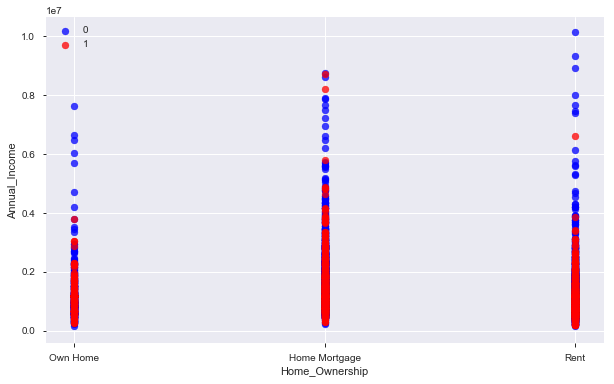

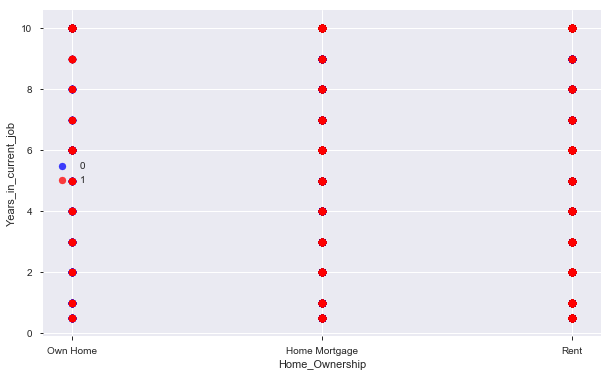

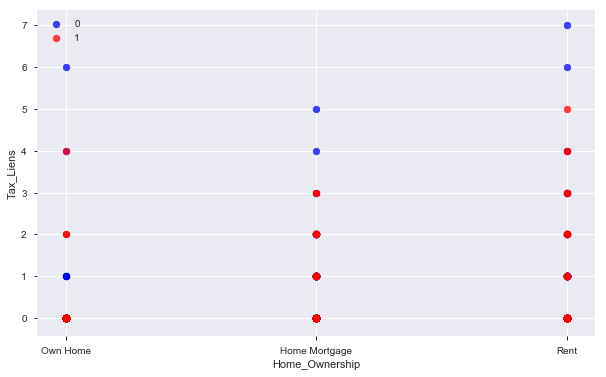

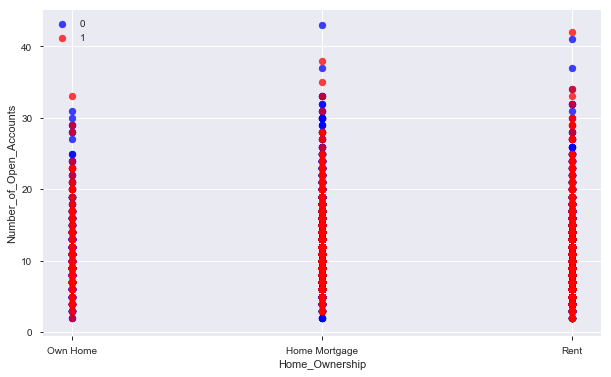

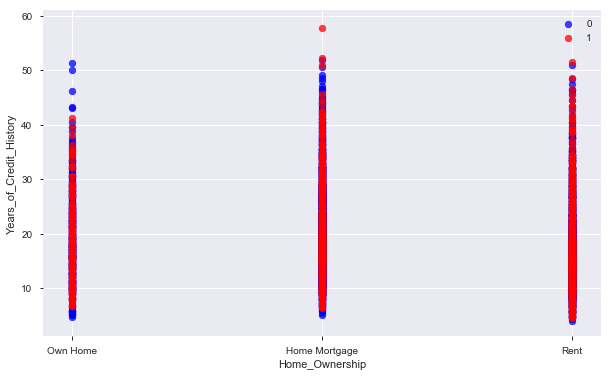

...

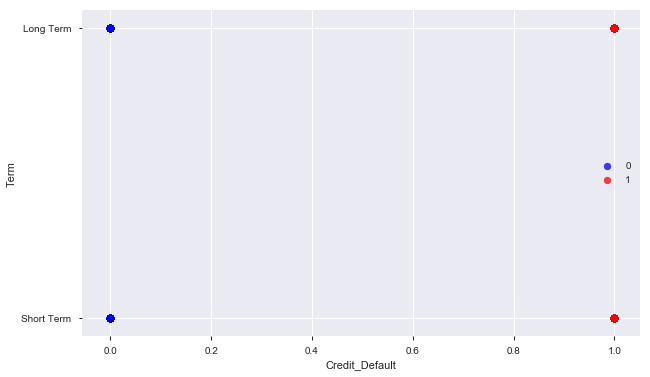

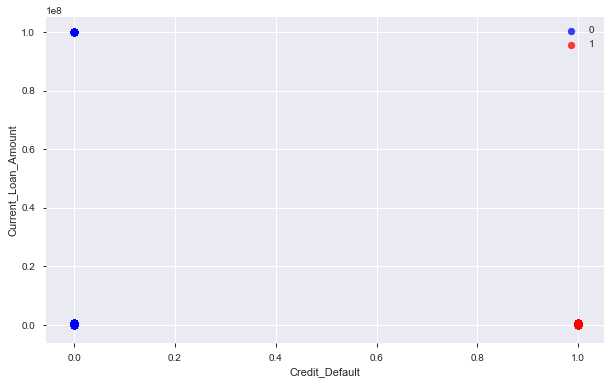

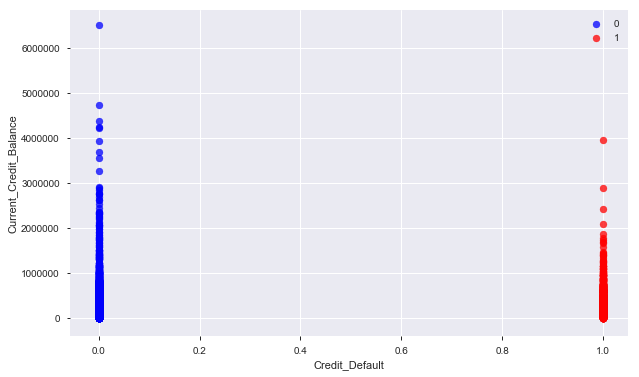

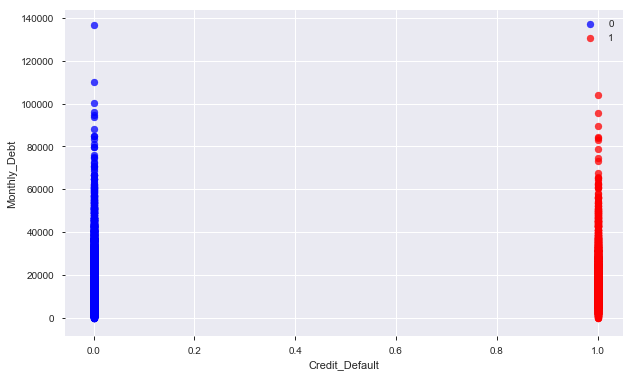

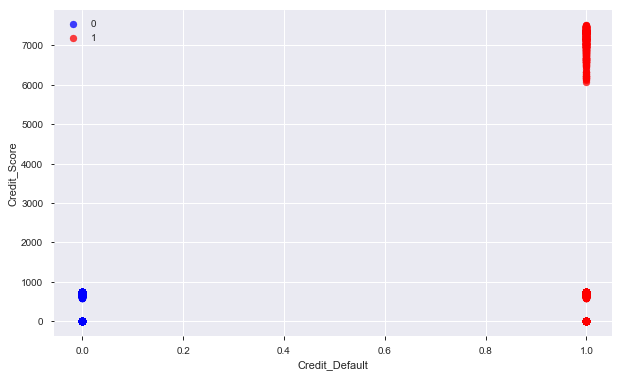

In [36]:
# Обзор всех переменных по отношению друг к другу относительно недефолтных значений

for col1 in df.columns:
    for col2 in df.columns:
        if col1 != col2:
            scat(df,col1, col2)

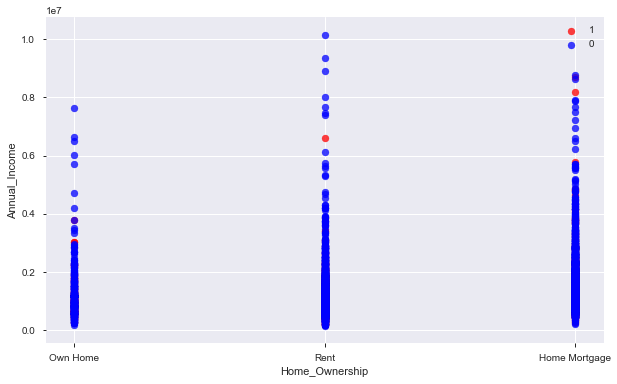

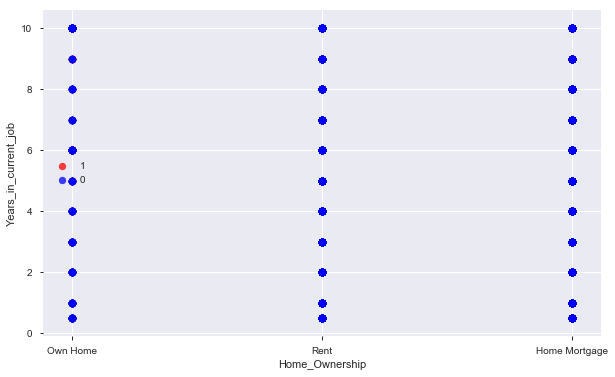

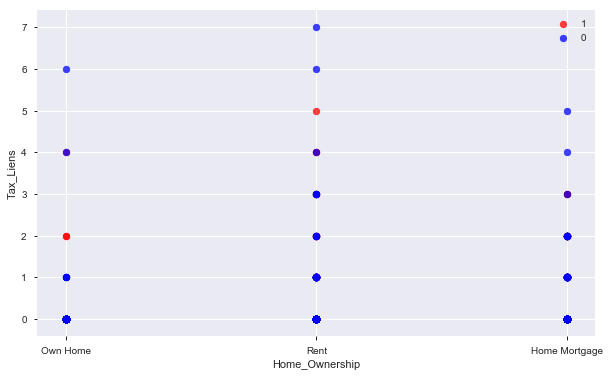

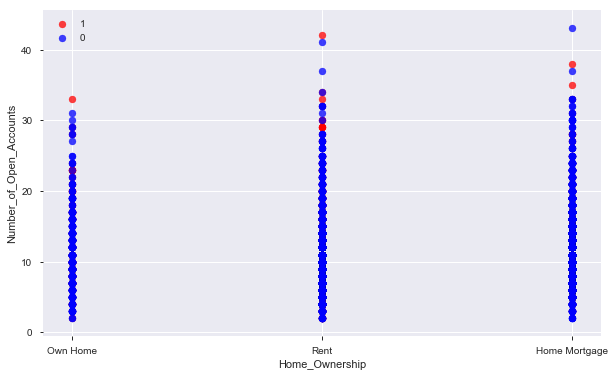

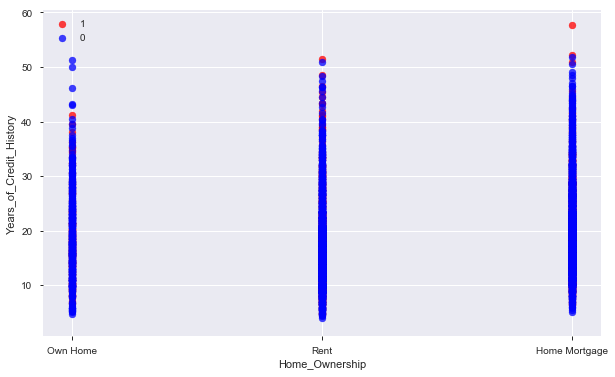

...

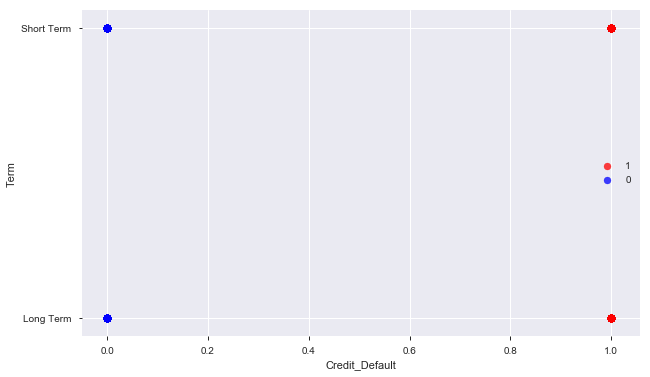

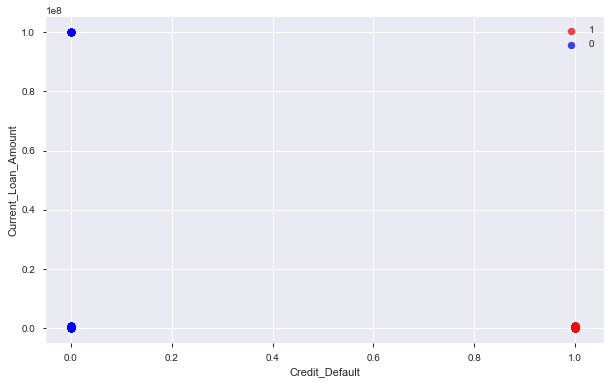

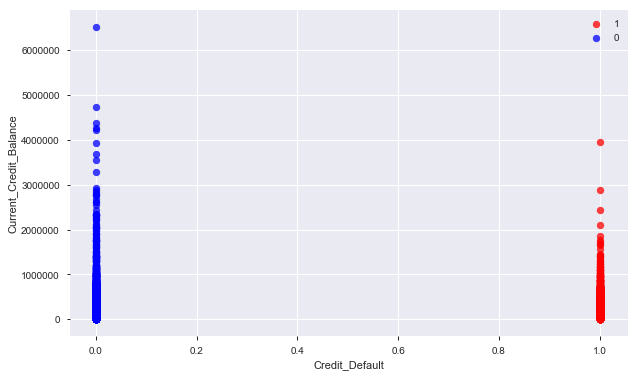

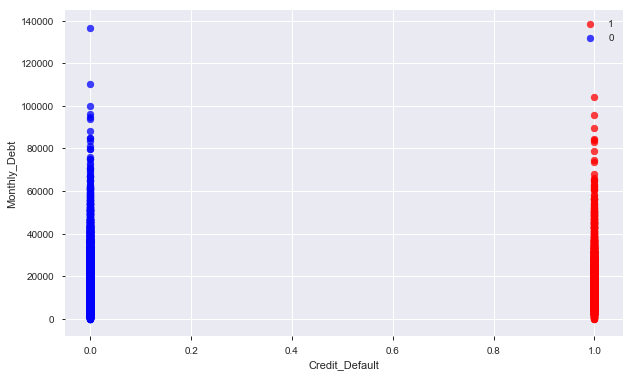

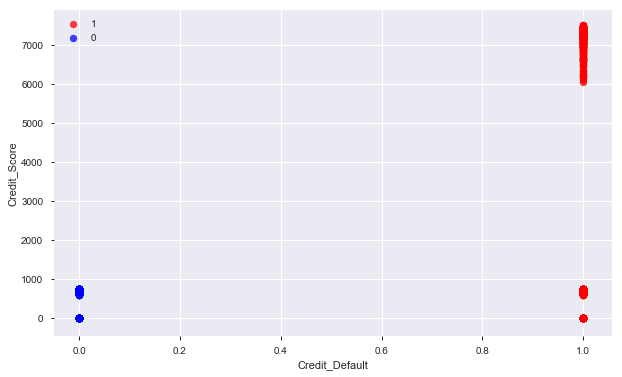

In [37]:
# Обзор всех переменных по отношению друг к другу относительно дефолтных значений


for col1 in df.columns:
    for col2 in df.columns:
        if col1 != col2:
            scat2(df,col1, col2)

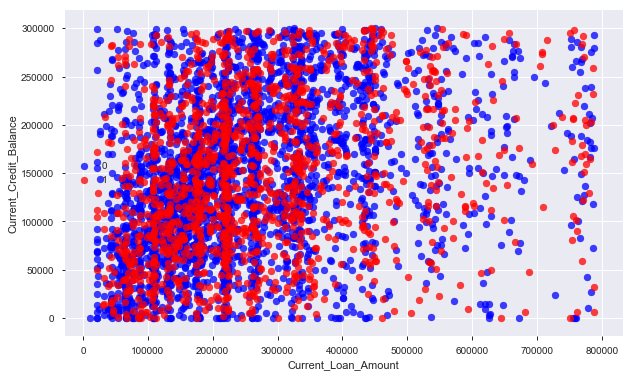

In [38]:
# Отдельный график для колонок с выбросами

col1 = 'Current_Loan_Amount'
col2 = 'Current_Credit_Balance'

plt.figure(figsize=(10, 6))


plt.scatter(df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==0)&(df['Current_Credit_Balance']<300000),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==0)&(df['Current_Credit_Balance']<300000),'Current_Credit_Balance'],
            alpha=0.75,
            color='blue',
            label='0')

plt.scatter(df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==1)&(df['Current_Credit_Balance']<300000),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==1)&(df['Current_Credit_Balance']<300000),'Current_Credit_Balance'],
            alpha=0.75,
            color='red',
            label='1')


plt.xlabel(col1)
plt.ylabel(col2)
plt.legend(loc='best');

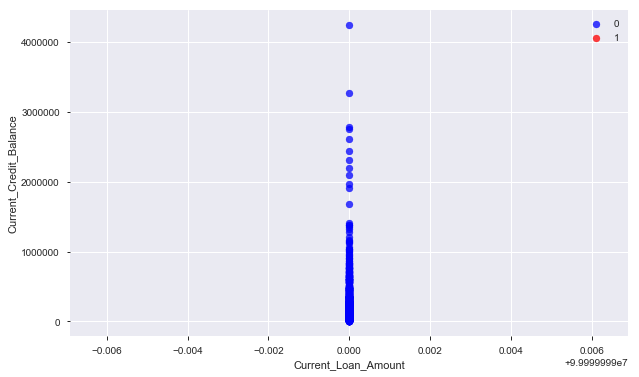

In [39]:
col1 = 'Current_Loan_Amount'
col2 = 'Current_Credit_Balance'

plt.figure(figsize=(10, 6))


plt.scatter(df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==0),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==0),'Current_Credit_Balance'],
            alpha=0.75,
            color='blue',
            label='0')

plt.scatter(df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==1),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==1),'Current_Credit_Balance'],
            alpha=0.75,
            color='red',
            label='1')


plt.xlabel(col1)
plt.ylabel(col2)
plt.legend(loc='best');

### Построение новых признаков<a class="anchor" id="new_features"></a>

**Id**

In [40]:
df['ID'] = df.index.tolist()

In [41]:
df.loc[df['Current_Loan_Amount']>=2000000, 'Large_CLA'] = 1
df['Large_CLA'] = df['Large_CLA'].fillna(0).astype(int)

In [42]:
df.loc[df['Credit_Score']>=5000, 'Large_CScore'] = 1
df['Large_CScore'] = df['Large_CScore'].fillna(0).astype(int)

**Dummies**

In [43]:
df['Term'] = df['Term'].map({'Long Term':'1', 'Short Term':'0'}).astype(int)

In [44]:
df.loc[(df['Purpose'] == 'home improvements')|(df['Purpose'] == 'major purchase')|(df['Purpose'] == 'take a trip')|(df['Purpose'] =='wedding')|(df['Purpose'] =='moving')|(df['Purpose'] =='vacation')|(df['Purpose'] =='renewable energy')|(df['Purpose'] =='buy a car'), 'Purpose'] = 'consumption'


In [45]:
df.loc[(df['Purpose'] == 'business loan')|(df['Purpose'] == 'small business'), 'Purpose'] = 'business'

In [46]:
df['Purpose'].value_counts()

debt consolidation      5944
other                    665
consumption              621
business                 155
medical bills             71
buy house                 34
educational expenses      10
Name: Purpose, dtype: int64

In [47]:
df.dtypes

Home_Ownership                   object
Annual_Income                   float64
Years_in_current_job            float64
Tax_Liens                       float64
Number_of_Open_Accounts         float64
Years_of_Credit_History         float64
Maximum_Open_Credit             float64
Number_of_Credit_Problems       float64
Months_since_last_delinquent    float64
Bankruptcies                    float64
Purpose                          object
Term                              int32
Current_Loan_Amount             float64
Current_Credit_Balance          float64
Monthly_Debt                    float64
Credit_Score                    float64
Credit_Default                    int64
ID                                int64
Large_CLA                         int32
Large_CScore                      int32
dtype: object

In [48]:
for cat_colname in df.select_dtypes(include='object').columns[1:]:
    df = pd.concat([df, pd.get_dummies(df[cat_colname], prefix=cat_colname)], axis=1)

In [49]:
df = pd.concat([df, pd.get_dummies(df['Home_Ownership'], prefix='Home_Ownership')], axis=1)

In [50]:
df.head(10)

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,...,Purpose_business,Purpose_buy house,Purpose_consumption,Purpose_debt consolidation,Purpose_educational expenses,Purpose_medical bills,Purpose_other,Home_Ownership_Home Mortgage,Home_Ownership_Own Home,Home_Ownership_Rent
0,Own Home,482087.0,6.0,0.0,11.0,26.3,685960.0,1.0,32.0,1.0,...,0,0,0,1,0,0,0,0,1,0
1,Own Home,1025487.0,10.0,0.0,15.0,15.3,1181730.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,0,1,0
2,Home Mortgage,751412.0,8.0,0.0,11.0,35.0,1182434.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,1,0,0
3,Own Home,805068.0,6.0,0.0,8.0,22.5,147400.0,1.0,32.0,1.0,...,0,0,0,1,0,0,0,0,1,0
4,Rent,776264.0,8.0,0.0,13.0,13.6,385836.0,1.0,32.0,0.0,...,0,0,0,1,0,0,0,0,0,1
5,Rent,1168386.0,7.0,0.0,12.0,14.6,366784.0,0.0,32.0,0.0,...,0,0,0,0,0,0,1,0,0,1
6,Home Mortgage,1511108.0,10.0,0.0,9.0,20.3,388124.0,0.0,73.0,0.0,...,0,0,1,0,0,0,0,1,0,0
7,Rent,1040060.0,10.0,0.0,13.0,12.0,330374.0,0.0,18.0,0.0,...,0,0,0,0,0,0,1,0,0,1
8,Home Mortgage,1168386.0,5.0,0.0,17.0,15.7,0.0,1.0,32.0,1.0,...,0,0,1,0,0,0,0,1,0,0
9,Home Mortgage,1168386.0,1.0,0.0,10.0,24.6,511302.0,0.0,6.0,0.0,...,0,0,0,1,0,0,0,1,0,0


### Сохранение обучающего датасета<a class="anchor" id="saving"></a>

In [51]:
df.to_csv(PREP_DATASET_PATH, index=False, encoding='utf-8')

In [52]:
pandas_profiling.ProfileReport(df)

In [53]:
def get_classification_report(y_train_true, y_train_pred, y_test_true, y_test_pred):
    print('TRAIN\n\n' + classification_report(y_train_true, y_train_pred))
    print('TEST\n\n' + classification_report(y_test_true, y_test_pred))
    print('CONFUSION MATRIX\n')
    print(pd.crosstab(y_test_true, y_test_pred))

In [54]:
def balance_df_by_target(df, target_name):

    target_counts = df[target_name].value_counts()

    major_class_name = target_counts.argmax()
    minor_class_name = target_counts.argmin()

    disbalance_coeff = int(target_counts[major_class_name] / target_counts[minor_class_name]) - 1

    for i in range(disbalance_coeff):
        sample = df[df[target_name] == minor_class_name].sample(target_counts[minor_class_name])
        df = df.append(sample, ignore_index=True)

    return df.sample(frac=1) 

In [55]:
df_base = pd.read_csv(DATASET_PATH)

**Выделение целевой переменной и групп признаков**

In [56]:
pandas_profiling.ProfileReport(df_base)

In [57]:
TARGET_NAME = TARGET_COLUMN
BASE_FEATURE_NAMES = df_base.columns.drop(TARGET_NAME).tolist()
NEW_FEATURE_NAMES = df.columns.drop([TARGET_NAME, 'ID'] + BASE_FEATURE_NAMES).tolist()

### Отбор признаков<a class="anchor" id="feature_selection"></a>

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 30 columns):
Home_Ownership                  7500 non-null object
Annual_Income                   7500 non-null float64
Years_in_current_job            7500 non-null float64
Tax_Liens                       7500 non-null float64
Number_of_Open_Accounts         7500 non-null float64
Years_of_Credit_History         7500 non-null float64
Maximum_Open_Credit             7500 non-null float64
Number_of_Credit_Problems       7500 non-null float64
Months_since_last_delinquent    7500 non-null float64
Bankruptcies                    7500 non-null float64
Purpose                         7500 non-null object
Term                            7500 non-null int32
Current_Loan_Amount             7500 non-null float64
Current_Credit_Balance          7500 non-null float64
Monthly_Debt                    7500 non-null float64
Credit_Score                    7500 non-null float64
Credit_Default                  7

In [59]:
NUM_FEATURE_NAMES = ['Annual_Income', 'Years_in_current_job', 'Tax_Liens', 'Number_of_Open_Accounts',
                     'Years_of_Credit_History', 'Maximum_Open_Credit', 'Number_of_Credit_Problems',
                     'Months_since_last_delinquent', 'Bankruptcies', 'Term', 'Current_Loan_Amount',
                     'Current_Credit_Balance', 'Monthly_Debt']

CAT_FEATURE_NAMES = ['Home_Ownership', 'Purpose']

SELECTED_FEATURE_NAMES = NUM_FEATURE_NAMES + NEW_FEATURE_NAMES

### Приведение типов для модели CatBoost

In [60]:
for colname in CAT_FEATURE_NAMES:
    df[colname] = pd.Categorical(df[colname])
    
df[CAT_FEATURE_NAMES].dtypes

Home_Ownership    category
Purpose           category
dtype: object

### Нормализация данных<a class="anchor" id="normalization"></a>

In [61]:
scaler = StandardScaler()

df_norm = df.copy()
df_norm[NUM_FEATURE_NAMES] = scaler.fit_transform(df_norm[NUM_FEATURE_NAMES])

df = df_norm.copy()

**Сохранение модели для нормализации данных**

In [62]:
with open(SCALER_FILE_PATH, 'wb') as file:
    pickle.dump(scaler, file)

### Разбиение на train и test<a class="anchor" id="train_and_test"></a>

In [63]:
X = df[SELECTED_FEATURE_NAMES]
y = df[TARGET_NAME]

X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=True, test_size=0.30, random_state=21)

### Балансировка целевой переменной<a class="anchor" id="target_balancing"></a>

In [64]:
df_for_balancing = pd.concat([X_train, y_train], axis=1)
df_balanced = balance_df_by_target(df_for_balancing, TARGET_NAME)
    
df_balanced[TARGET_NAME].value_counts()

0    3771
1    2958
Name: Credit_Default, dtype: int64

In [65]:
X_train = df_balanced.drop(columns=TARGET_NAME)
y_train = df_balanced[TARGET_NAME]

### Сохранение обучающего и тестового датасетов<a class="anchor" id="train_test_saving"></a> 

In [66]:
train = pd.concat([X_train, y_train], axis=1)
test = pd.concat([X_test, y_test], axis=1)

In [67]:
df.to_csv(TRAIN_FULL_PATH, index=False, encoding='utf-8')
train.to_csv(TRAIN_PART_PATH, index=False, encoding='utf-8')
test.to_csv(TEST_PART_PATH, index=False, encoding='utf-8')

### Построение и оценка базовых моделей<a class="anchor" id="baseline_modeling"></a> 

**Логистическая регрессия**

In [68]:
model_lr = LogisticRegression(random_state=21)
model_lr.fit(X_train, y_train)


y_train_pred = model_lr.predict(X_train)
y_test_pred = model_lr.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.69      0.83      0.75      3771
           1       0.71      0.52      0.60      2958

   micro avg       0.70      0.70      0.70      6729
   macro avg       0.70      0.68      0.68      6729
weighted avg       0.70      0.70      0.69      6729

TEST

              precision    recall  f1-score   support

           0       0.81      0.81      0.81      1616
           1       0.52      0.51      0.51       634

   micro avg       0.73      0.73      0.73      2250
   macro avg       0.66      0.66      0.66      2250
weighted avg       0.73      0.73      0.73      2250

CONFUSION MATRIX

col_0              0    1
Credit_Default           
0               1317  299
1                313  321


**k ближайших соседей**

In [69]:
model_knn = KNeighborsClassifier()
model_knn.fit(X_train, y_train)

y_train_pred = model_knn.predict(X_train)
y_test_pred = model_knn.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.78      0.85      0.81      3771
           1       0.78      0.70      0.74      2958

   micro avg       0.78      0.78      0.78      6729
   macro avg       0.78      0.77      0.78      6729
weighted avg       0.78      0.78      0.78      6729

TEST

              precision    recall  f1-score   support

           0       0.78      0.75      0.76      1616
           1       0.42      0.46      0.44       634

   micro avg       0.67      0.67      0.67      2250
   macro avg       0.60      0.60      0.60      2250
weighted avg       0.68      0.67      0.67      2250

CONFUSION MATRIX

col_0              0    1
Credit_Default           
0               1206  410
1                343  291


**Бустинговые алгоритмы**

*XGBoost*

In [70]:
model_xgb = xgb.XGBClassifier(random_state=21)
model_xgb.fit(X_train, y_train)

y_train_pred = model_xgb.predict(X_train)
y_test_pred = model_xgb.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.72      0.87      0.79      3771
           1       0.78      0.58      0.66      2958

   micro avg       0.74      0.74      0.74      6729
   macro avg       0.75      0.72      0.73      6729
weighted avg       0.75      0.74      0.74      6729

TEST

              precision    recall  f1-score   support

           0       0.81      0.85      0.83      1616
           1       0.56      0.49      0.52       634

   micro avg       0.75      0.75      0.75      2250
   macro avg       0.68      0.67      0.68      2250
weighted avg       0.74      0.75      0.74      2250

CONFUSION MATRIX

col_0              0    1
Credit_Default           
0               1371  245
1                322  312


*LightGBM*

In [71]:
model_lgbm = lgbm.LGBMClassifier(random_state=21)
model_lgbm.fit(X_train, y_train)

y_train_pred = model_lgbm.predict(X_train)
y_test_pred = model_lgbm.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.91      0.96      0.94      3771
           1       0.94      0.89      0.91      2958

   micro avg       0.93      0.93      0.93      6729
   macro avg       0.93      0.92      0.92      6729
weighted avg       0.93      0.93      0.93      6729

TEST

              precision    recall  f1-score   support

           0       0.80      0.85      0.82      1616
           1       0.55      0.48      0.51       634

   micro avg       0.74      0.74      0.74      2250
   macro avg       0.68      0.66      0.67      2250
weighted avg       0.73      0.74      0.74      2250

CONFUSION MATRIX

col_0              0    1
Credit_Default           
0               1366  250
1                331  303


*CatBoost*

In [72]:
model_catb = catb.CatBoostClassifier(silent=True, random_state=21)
model_catb.fit(X_train, y_train)

y_train_pred = model_catb.predict(X_train)
y_test_pred = model_catb.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.92      0.96      0.94      3771
           1       0.95      0.90      0.92      2958

   micro avg       0.93      0.93      0.93      6729
   macro avg       0.94      0.93      0.93      6729
weighted avg       0.93      0.93      0.93      6729

TEST

              precision    recall  f1-score   support

           0       0.81      0.85      0.83      1616
           1       0.56      0.48      0.52       634

   micro avg       0.75      0.75      0.75      2250
   macro avg       0.68      0.67      0.67      2250
weighted avg       0.74      0.75      0.74      2250

CONFUSION MATRIX

col_0            0.0  1.0
Credit_Default           
0               1371  245
1                327  307


### Выбор лучшей модели и подбор гиперпараметров<a class="anchor" id="tuning_best_model"></a> 

In [122]:
model_catb = catb.CatBoostClassifier(class_weights=[1, 3.5], silent=True, random_state=21)

#  

**Подбор гиперпараметров**

In [123]:
params = {'n_estimators':[50, 100, 200, 500, 700, 1000, 1200, 1500],
          'max_depth':[3, 5, 7],
          'learning_rate':[0.01, 0.05, 0.1],
          'l2_leaf_reg':[3, 11, 12, 13]}

In [124]:
cv=KFold(n_splits=3, random_state=21, shuffle=True)

In [125]:
%%time

rs = RandomizedSearchCV(model_catb, params, scoring='f1', cv=cv, n_jobs=-1)

rs.fit(X, y)

Wall time: 5min 22s


In [127]:
rs.best_params_

{'n_estimators': 1500,
 'max_depth': 7,
 'learning_rate': 0.01,
 'l2_leaf_reg': 12}

In [126]:
rs.best_score_

0.542764245119533

**Обучение и оценка финальной модели**

In [128]:
%%time

final_model = catb.CatBoostClassifier(n_estimators=1500, max_depth=7, learning_rate=0.01, l2_leaf_reg=12,
                                      silent=True, random_state=21)
final_model.fit(X_train, y_train)

y_train_pred = final_model.predict(X_train)
y_test_pred = final_model.predict(X_test)

get_classification_report(y_train, y_train_pred, y_test, y_test_pred)

TRAIN

              precision    recall  f1-score   support

           0       0.84      0.93      0.89      3771
           1       0.90      0.78      0.84      2958

   micro avg       0.86      0.86      0.86      6729
   macro avg       0.87      0.86      0.86      6729
weighted avg       0.87      0.86      0.86      6729

TEST

              precision    recall  f1-score   support

           0       0.81      0.85      0.83      1616
           1       0.56      0.50      0.53       634

   micro avg       0.75      0.75      0.75      2250
   macro avg       0.69      0.67      0.68      2250
weighted avg       0.74      0.75      0.74      2250

CONFUSION MATRIX

col_0            0.0  1.0
Credit_Default           
0               1371  245
1                320  314
Wall time: 23.7 s


 ### Предсказание тестового датасета

### Функция обработки датасета

In [80]:
def prepare_data(df, median_Annual_Income, median_Years_in_current_job, median_Months_since_last_delinquent):
    df.loc[df['Home_Ownership']=='Have Mortgage', 'Home_Ownership']='Home Mortgage'

    # Заполнение пустых значений колонки медианными
    
    df['Annual_Income'] = df['Annual_Income'].fillna(median_Annual_Income)

    # Изменение данных в колонке на числовые
    
    change_years = {'10+ years':10.0, '8 years':8.0, '6 years':6.0, '7 years':7.0, '5 years':5.0, '1 year':1.0,
                    '< 1 year':0.5, '4 years':4.0, '3 years':3.0, '2 years':2.0, '9 years':9.0}
    df.Years_in_current_job.replace(to_replace=change_years, inplace=True)
    
    df['Years_in_current_job'] = df['Years_in_current_job'].fillna(median_Years_in_current_job)

    # Обработка выброса
    
    df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] > 10 ), 'Maximum_Open_Credit'] = df['Annual_Income'] * 10

    # Заполнение пустых значений колонки медианными
    
    df['Months_since_last_delinquent'] = df['Months_since_last_delinquent'].fillna(median_Months_since_last_delinquent)
    
    # Заполнение пустых значений колонок нулями
    
    df['Bankruptcies'] = df['Bankruptcies'].fillna(0)
    df['Credit_Score'] = df['Credit_Score'].fillna(0)

    # Добавление ID
    df['ID'] = df.index.tolist()
    
    # Добавление признака большого значения Credit Loan Amount, (при котором все Credit Default = 0)
    
    df.loc[df['Current_Loan_Amount']>=2000000, 'Large_CLA'] = 1
    df['Large_CLA'] = df['Large_CLA'].fillna(0).astype(int)
    
    # Добавление признака большого значения Credit Score, (при котором все Credit Default = 1)
    
    df.loc[df['Credit_Score']>=5000, 'Large_CScore'] = 1
    df['Large_CScore'] = df['Large_CScore'].fillna(0).astype(int)
    
    # Изменение значений категориальной переменной с 2мя категориями на 1 и 0
    
    df['Term'] = df['Term'].map({'Long Term':'1', 'Short Term':'0'}).astype(int)
    
    # Объединение "одинаковых" признаков
    
    df.loc[(df['Purpose'] == 'home improvements')|(df['Purpose'] == 'major purchase')|(df['Purpose'] == 'take a trip')|(df['Purpose'] =='wedding')|(df['Purpose'] =='moving')|(df['Purpose'] =='vacation')|(df['Purpose'] =='renewable energy')|(df['Purpose'] =='buy a car'), 'Purpose'] = 'consumption'
    df.loc[(df['Purpose'] == 'business loan')|(df['Purpose'] == 'small business'), 'Purpose'] = 'business'

    # Dummies
    
    for cat_colname in df.select_dtypes(include='object').columns[1:]:
        df = pd.concat([df, pd.get_dummies(df[cat_colname], prefix=cat_colname)], axis=1)
    
    df = pd.concat([df, pd.get_dummies(df['Home_Ownership'], prefix='Home_Ownership')], axis=1)
    
    return df
    

In [81]:
DATASET_TEST_PATH = 'course_project_test.csv'

In [82]:
df_base_test = pd.read_csv(DATASET_TEST_PATH)

In [83]:
df_base_test.head()

,Home Ownership,Annual Income,Years in current job,Tax Liens,Number of Open Accounts,Years of Credit History,Maximum Open Credit,Number of Credit Problems,Months since last delinquent,Bankruptcies,Purpose,Term,Current Loan Amount,Current Credit Balance,Monthly Debt,Credit Score
0,Rent,NaN,4 years,0.0,9.0,12.5,220968.0,0.0,70.0,0.0,debt consolidation,Short Term,162470.0,105906.0,6813.0,NaN
1,Rent,231838.0,1 year,0.0,6.0,32.7,55946.0,0.0,8.0,0.0,educational expenses,Short Term,78298.0,46037.0,2318.0,699.0
2,Home Mortgage,1152540.0,3 years,0.0,10.0,13.7,204600.0,0.0,NaN,0.0,debt consolidation,Short Term,200178.0,146490.0,18729.0,7260.0
3,Home Mortgage,1220313.0,10+ years,0.0,16.0,17.0,456302.0,0.0,70.0,0.0,debt consolidation,Short Term,217382.0,213199.0,27559.0,739.0
4,Home Mortgage,2340952.0,6 years,0.0,11.0,23.6,1207272.0,0.0,NaN,0.0,debt consolidation,Long Term,777634.0,425391.0,42605.0,706.0


In [84]:
df_base_test.describe()

,Annual Income,Tax Liens,Number of Open Accounts,Years of Credit History,Maximum Open Credit,Number of Credit Problems,Months since last delinquent,Bankruptcies,Current Loan Amount,Current Credit Balance,Monthly Debt,Credit Score
count,1.987000e+03,2500.000000,2500.000000,2500.000000,2.500000e+03,2500.000000,1142.000000,2497.000000,2.500000e+03,2.500000e+03,2500.000000,1987.000000
mean,1.366922e+06,0.035200,11.184400,18.325920,7.105704e+05,0.162000,34.181261,0.106928,1.215572e+07,2.963966e+05,18271.340000,1234.516860
std,9.171252e+05,0.386291,4.852774,7.254659,1.511983e+06,0.559894,22.024277,0.357189,3.226097e+07,3.783020e+05,11543.881469,1740.219442
min,1.065330e+05,0.000000,1.000000,3.900000,0.000000e+00,0.000000,0.000000,0.000000,1.542200e+04,0.000000e+00,93.000000,585.000000
25%,8.523115e+05,0.000000,8.000000,13.400000,2.785860e+05,0.000000,16.000000,0.000000,1.871265e+05,1.101145e+05,10024.750000,710.000000
50%,1.178475e+06,0.000000,10.000000,17.000000,4.786760e+05,0.000000,30.000000,0.000000,3.223660e+05,2.073850e+05,16642.500000,731.000000
75%,1.629734e+06,0.000000,14.000000,22.100000,8.025985e+05,0.000000,50.000000,0.000000,5.225825e+05,3.663485e+05,24146.000000,743.000000
max,1.497561e+07,15.000000,48.000000,53.400000,5.448439e+07,15.000000,82.000000,5.000000,1.000000e+08,6.030087e+06,93555.000000,7480.000000


In [85]:
df_base_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 16 columns):
Home Ownership                  2500 non-null object
Annual Income                   1987 non-null float64
Years in current job            2414 non-null object
Tax Liens                       2500 non-null float64
Number of Open Accounts         2500 non-null float64
Years of Credit History         2500 non-null float64
Maximum Open Credit             2500 non-null float64
Number of Credit Problems       2500 non-null float64
Months since last delinquent    1142 non-null float64
Bankruptcies                    2497 non-null float64
Purpose                         2500 non-null object
Term                            2500 non-null object
Current Loan Amount             2500 non-null float64
Current Credit Balance          2500 non-null float64
Monthly Debt                    2500 non-null float64
Credit Score                    1987 non-null float64
dtypes: float64(12), object(4)
me

In [86]:
pandas_profiling.ProfileReport(df_base_test)

### Подготовка тестового датасета

In [87]:
df_prep_test = df_base_test.copy()
df_prep_test = prepare_data(df_prep_test, median_Annual_Income, median_Years_in_current_job, median_Months_since_last_delinquent)

In [88]:
df_prep_test.head()

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,...,Purpose_business,Purpose_buy house,Purpose_consumption,Purpose_debt consolidation,Purpose_educational expenses,Purpose_medical bills,Purpose_other,Home_Ownership_Home Mortgage,Home_Ownership_Own Home,Home_Ownership_Rent
0,Rent,1168386.0,4.0,0.0,9.0,12.5,220968.0,0.0,70.0,0.0,...,0,0,0,1,0,0,0,0,0,1
1,Rent,231838.0,1.0,0.0,6.0,32.7,55946.0,0.0,8.0,0.0,...,0,0,0,0,1,0,0,0,0,1
2,Home Mortgage,1152540.0,3.0,0.0,10.0,13.7,204600.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,1,0,0
3,Home Mortgage,1220313.0,10.0,0.0,16.0,17.0,456302.0,0.0,70.0,0.0,...,0,0,0,1,0,0,0,1,0,0
4,Home Mortgage,2340952.0,6.0,0.0,11.0,23.6,1207272.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,1,0,0


In [89]:
df_prep_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 29 columns):
Home_Ownership                  2500 non-null object
Annual_Income                   2500 non-null float64
Years_in_current_job            2500 non-null float64
Tax_Liens                       2500 non-null float64
Number_of_Open_Accounts         2500 non-null float64
Years_of_Credit_History         2500 non-null float64
Maximum_Open_Credit             2500 non-null float64
Number_of_Credit_Problems       2500 non-null float64
Months_since_last_delinquent    2500 non-null float64
Bankruptcies                    2500 non-null float64
Purpose                         2500 non-null object
Term                            2500 non-null int32
Current_Loan_Amount             2500 non-null float64
Current_Credit_Balance          2500 non-null float64
Monthly_Debt                    2500 non-null float64
Credit_Score                    2500 non-null float64
ID                              2

In [90]:
TARGET_NAME_TEST = 'Credit_Default'
BASE_FEATURE_NAMES_TEST = df_base_test.columns.tolist()

NEW_FEATURE_NAMES_TEST = df_prep_test.columns.drop(['ID'] + BASE_FEATURE_NAMES_TEST).tolist()

### Приведение типов для модели CatBoost (Test Dataset)

In [91]:
for colname in CAT_FEATURE_NAMES:
    df_prep_test[colname] = pd.Categorical(df_prep_test[colname])
    
df_prep_test[CAT_FEATURE_NAMES].dtypes

Home_Ownership    category
Purpose           category
dtype: object

### Нормализация данных (Test Dataset) <a class="anchor" id="normalization"></a>

In [92]:
df_prep_test_norm = df_prep_test.copy()
df_prep_test_norm[NUM_FEATURE_NAMES] = scaler.transform(df_prep_test_norm[NUM_FEATURE_NAMES])

df_prep_test = df_prep_test_norm.copy()

### Итоговый расчет по финальной модели

In [93]:
pandas_profiling.ProfileReport(df_prep_test)

In [129]:
y_prep_test = final_model.predict(df_prep_test[SELECTED_FEATURE_NAMES])

In [130]:
y_prep_test

array([0., 1., 1., ..., 1., 0., 1.])

### Сохранение предсказания

In [114]:
df_prep_test['ID'] = df_prep_test['ID'] + 7500
df_prep_test['ID']

0       7500
1       7501
2       7502
3       7503
4       7504
        ... 
2495    9995
2496    9996
2497    9997
2498    9998
2499    9999
Name: ID, Length: 2500, dtype: int64

In [131]:
pred_final = pd.concat([df_prep_test['ID'], pd.Series(y_prep_test.astype(int))], axis=1)
pred_final.rename(columns={'ID': 'id', 0: 'Credit Default'}, inplace=True)
pred_final

,id,Credit Default
0,7500,0
1,7501,1
2,7502,1
3,7503,0
4,7504,0
...,...,...
2495,9995,0
2496,9996,1
2497,9997,1
2498,9998,0


In [132]:
pred_final.to_csv('MLukyanov_predictions.csv', index=None)